In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np
import IPython.display as display
from IPython.display import clear_output
import time

np.random.seed(42)

In [ ]:
!pip install opencv-python
!pip install opencv-python-headless
!pip install matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Hyperparameters and Constants
Define wether to train the model or not and for how many epochs to train for.

note : If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [ ]:
TRAIN = False

In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 30

## Download and Prepare the Dataset

We use the <a href="https://public.roboflow.com/object-detection/vehicles-openimages" target="_blank">Vehicles-OpenImages</a> dataset for training the custom YOLOv5 object detector.

Here we download the dataset.

In [ ]:
if not os.path.exists('train'):
    !curl -L "https://public.roboflow.com/ds/xKLV14HbTF?key=aJzo7msVta" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
    
    dirs = ['train', 'valid', 'test']

    for i, dir_name in enumerate(dirs):
        all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
        for j, image_name in enumerate(all_image_names):
            if (j % 2) == 0:
                file_name = image_name.split('.jpg')[0]
                os.remove(f"{dir_name}/images/{image_name}")
                os.remove(f"{dir_name}/labels/{file_name}.txt")

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   893  100   893    0     0   2136      0 --:--:-- --:--:-- --:--:--  2136
100 38.4M  100 38.4M    0     0  11.3M      0  0:00:03  0:00:03 --:--:-- 15.3M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/00dea1edf14f09ab_jpg.rf.3f17c8790a68659d03b1939a59ccda80.jpg  
 extracting: test/images/00dea1edf14f09ab_jpg.rf.KJ730oDTFPdXdJxvSLnX.jpg  
 extracting: test/images/00e481ea1a520175_jpg.rf.6e6a8b3b45c9a11d106958f88ff714ea.jpg  
 extracting: test/images/00e481ea1a520175_jpg.rf.MV6sZ8QCFwFeMYaI2tHm.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.7IkYAamjZhnwsoXSrwKt.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.effa65856584463c08848031cab357b9.jpg  
 extractin

The original data had two instances of each image and label file. 
The rest of the code in the above block deletes the duplicate image and it's corresponding text file containing the label (useful for future enhancment to the code).

The YOLOV5 dataset is structured in the following manner:

```
├── data.yaml
├── README.dataset.txt
├── README.roboflow.txt
├── test
│   ├── images
│   └── labels
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

## Helper Functions to Download Files

The following function is for downloading any file in the notebook. In further sections of the notebook, we will use it for downloading the inference data.

In [ ]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else: 
        print('File already present, skipping download...')

### The Dataset YAML File

The dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels is already provided. This file will also contain the class names from the dataset.

The dataset contains 5 classes: **'Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck'**.

The following block shows the contents of the `data.yaml` file.

```yaml
train: ../train/images
val: ../valid/images

nc: 5
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
```

### Visualize a Few Ground Truth Images

Checking out few of the ground truth images. 

(The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. here we just change it to write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format)

In [ ]:
class_names = ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

**SHAPE OF THE BOX AND HOW THE NAME OF THE VEHCILE DESPLAYED HERE**

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

To see some random samples of the dataset

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

In [ ]:
# Visualize a few training images.
plot(
    image_paths='train/images/*', 
    label_paths='train/labels/*',
    num_samples=4,
)

Output hidden; open in https://colab.research.google.com to view.

## Helper Functions for Logging

Here, we write the helper functions that we need for logging of the results in the notebook while training the models.

So that we can easily keep track of the result directories and carry out inference using the proper model.

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 15393, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 15393 (delta 9), reused 17 (delta 6), pack-reused 15369
Receiving objects: 100% (15393/15393), 14.31 MiB | 9.39 MiB/s, done.
Resolving deltas: 100% (10523/10523), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 18.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.1 MB/s eta 0:00:00


## Training using YOLOV5

Train the neural network model.

### Train a Small (yolov5s) Model

Training all the layers of the small model.

The training (my device and dataset limitation made me choose yolov5s and 50 epoch * next need to make it with better moduel and more training peroid)

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 0
results_1
train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-140-g1db9533 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_

In [ ]:
monitor_tensorboard()

Download best trained sample

In [ ]:
from google.colab import files

def download_weights(RES_DIR):
    weights_path = f"runs/train/{RES_DIR}/weights/best.pt"
    files.download(weights_path)

download_weights(RES_DIR)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Checking Out the Validation Predictions and Inference

In this section
1. we check out the predictions of the validation images saved during training. Along with that
2. we also check out inference of images and videos.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The following functions are for carrying out inference on images and videos.

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images or videos in any of the directories. The following function accepts a directory path and plots all the images in them. 

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The one above for images and now another one for videos

In [ ]:
from google.colab.patches import cv2_imshow

def visualize_vid(INFER_DIR, video_index=0):
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    video_paths = glob.glob(f"{INFER_PATH}/*.mp4")

    if video_index >= len(video_paths):
        print(f"Video index out of range. There are {len(video_paths)} videos.")
        return

    video_path = video_paths[video_index]

    # Display the video.
    video = cv2.VideoCapture(video_path)
    while video.isOpened():
        ret, frame = video.read()
        if not ret:
            break

        cv2_imshow(frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    video.release()
    cv2.destroyAllWindows()


**Visualize validation prediction images.**

In [ ]:
show_valid_results(RES_DIR)

Output hidden; open in https://colab.research.google.com to view.

### Inference
In this section, we carry out inference on unseen images and videos from the internet (new images and not the one used for training). 

The images for inference are in the `inference_images` directory.

The videos for inference are in the `inference_videos` directory.

### Download the Images and Videos
Here to download the images and videos that we use to carry inference upon ( when we want to try differend files this is the code to put the links in for download).

In [ ]:
download_file('https://learnopencv.s3.us-west-2.amazonaws.com/yolov5_inference_data.zip',
              'inference_data.zip')
if not os.path.exists('inference_images'):
    !unzip -q "inference_data.zip"
else:
    print('Dataset already present')

### Inference on Images

**To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.**

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/results_1/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-140-g1db9533 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/4 /content/yolov5/inference_images/image_1.jpg: 448x640 2 Ambulances, 5 Cars, 3 Trucks, 44.8ms
image 2/4 /content/yolov5/inference_images/image_2.jpg: 416x640 4 Cars, 50.7ms
image 3/4 /content/yolov5/inference_images/image_3.jpg: 448x640 2 Buss, 1 Motorcycle, 8.9

In [ ]:
visualize(IMAGE_INFER_DIR)

Output hidden; open in https://colab.research.google.com to view.

### Inference on Videos

In [ ]:
VIDEO_INFER_DIR = inference(RES_DIR, 'inference_videos')

Current number of inference detection directories: 1
inference_2
detect: weights=['runs/train/results_1/weights/best.pt'], source=inference_videos, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-140-g1db9533 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
video 1/4 (1/513) /content/yolov5/inference_videos/video_1.mp4: 384x640 (no detections), 48.2ms
video 1/4 (2/513) /content/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 7.9ms
video 1/4 (3/513) /content/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 7.9ms
vid

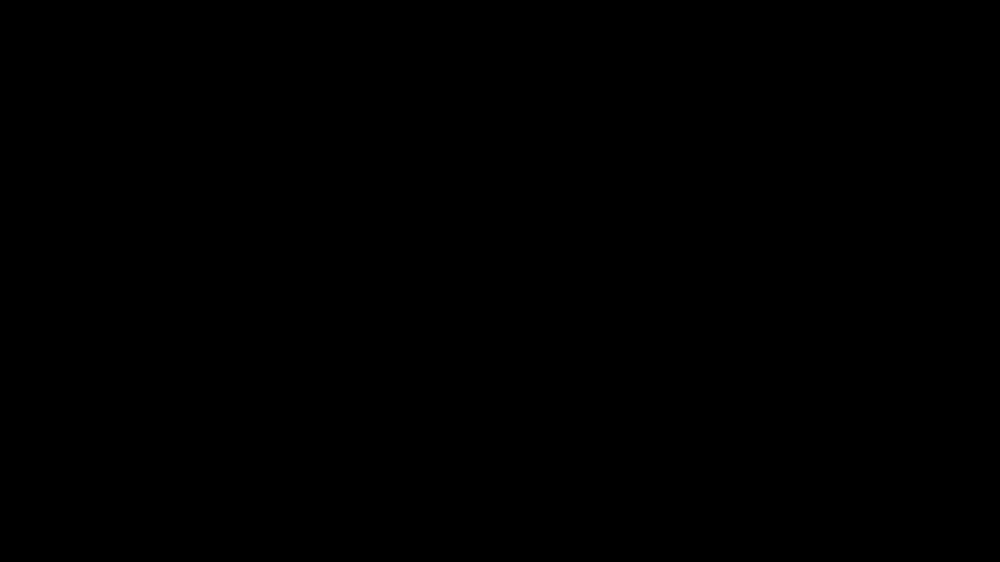

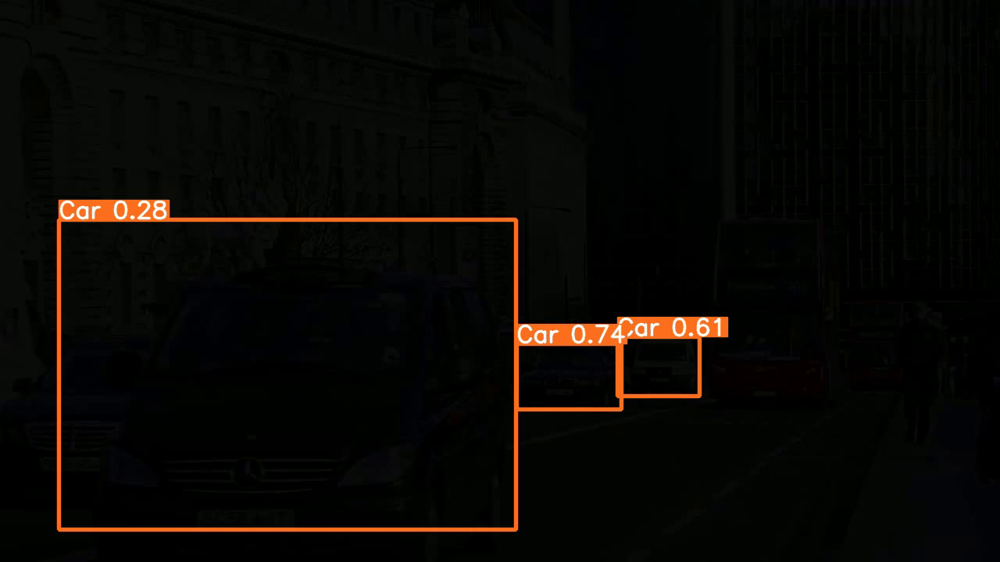

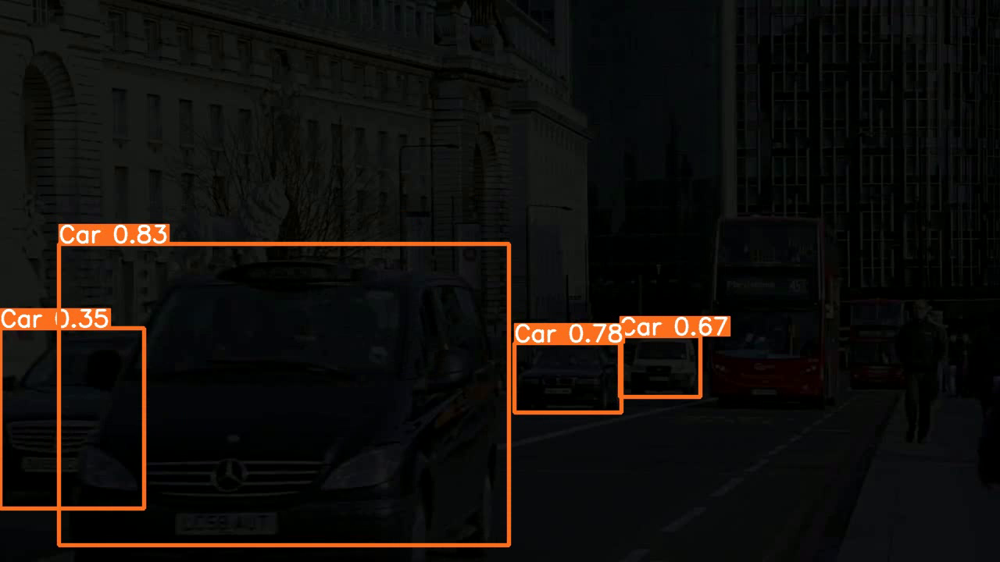

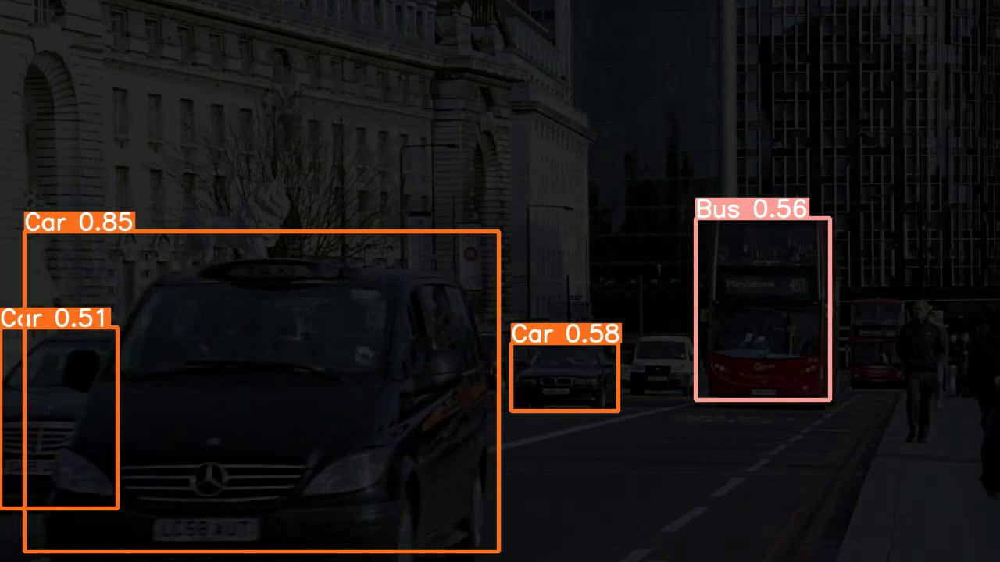

In [ ]:
visualize_vid(VIDEO_INFER_DIR, video_index=1)


Downloading the result video

In [ ]:
from google.colab import files

def download_video(INFER_DIR, video_index=1):
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    video_paths = glob.glob(f"{INFER_PATH}/*.mp4")

    if video_index >= len(video_paths):
        print(f"Video index out of range. There are {len(video_paths)} videos.")
        return

    video_path = video_paths[video_index]

    files.download(video_path)


In [ ]:
download_video(VIDEO_INFER_DIR, video_index=1)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Training and Inference using  Medium Model

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 1
results_2
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 27 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=

               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.351      0.451      0.407      0.234

     Epoch   gpu_mem       box       obj       cls    labels  img_size
      9/24     5.44G   0.04391   0.02324   0.01619        25       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.454       0.51      0.457      0.276

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     10/24     5.52G   0.04311   0.02166   0.01398        20       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.482      0.434      0.434      0.268

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     11/24     5.53G   0.04287   0.02324   0.01336        25       640: 100%|███
               Class     Images     L

In [ ]:
monitor_tensorboard()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 2
inference_3
detect: weights=['runs/train/results_2/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_3, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients
image 1/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_images/image_1.jpg: 448x640 2 Ambulances, 1 Car, 4 Trucks, Done. (0.021s)
image 2/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detect

['runs/detect/inference_3/image_1.jpg', 'runs/detect/inference_3/image_4.jpg', 'runs/detect/inference_3/image_2.jpg', 'runs/detect/inference_3/image_3.jpg']


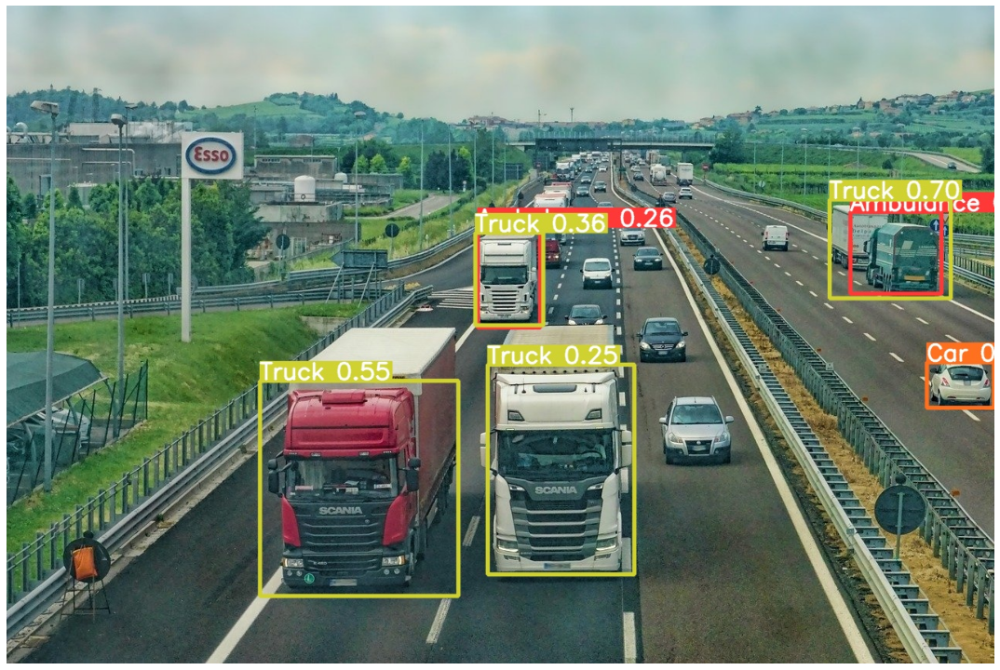

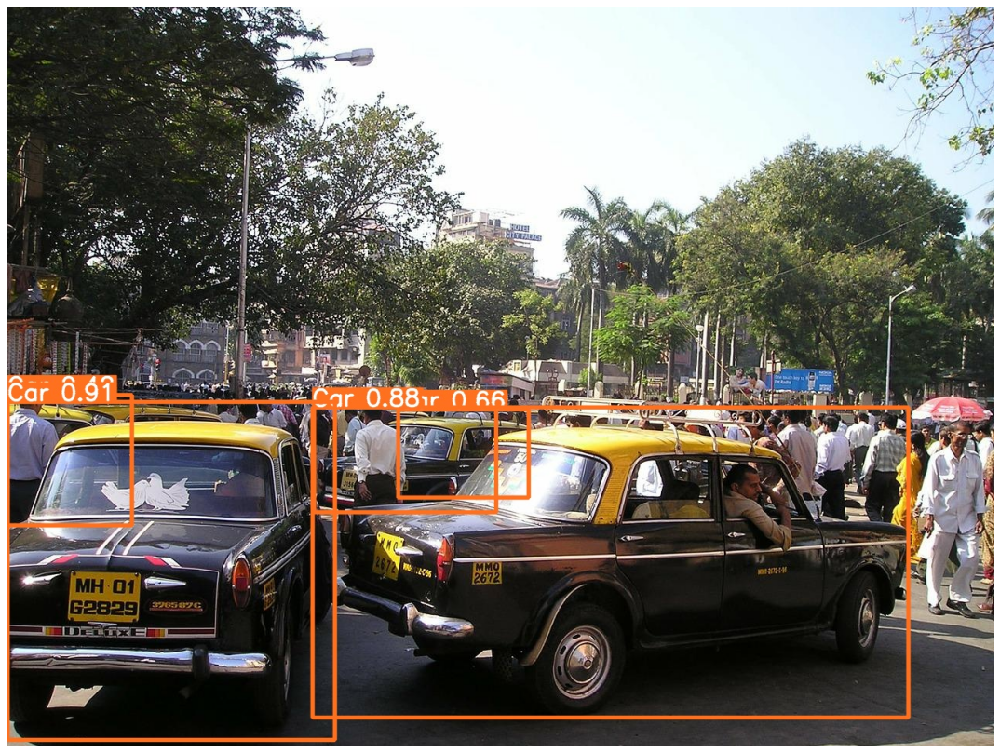

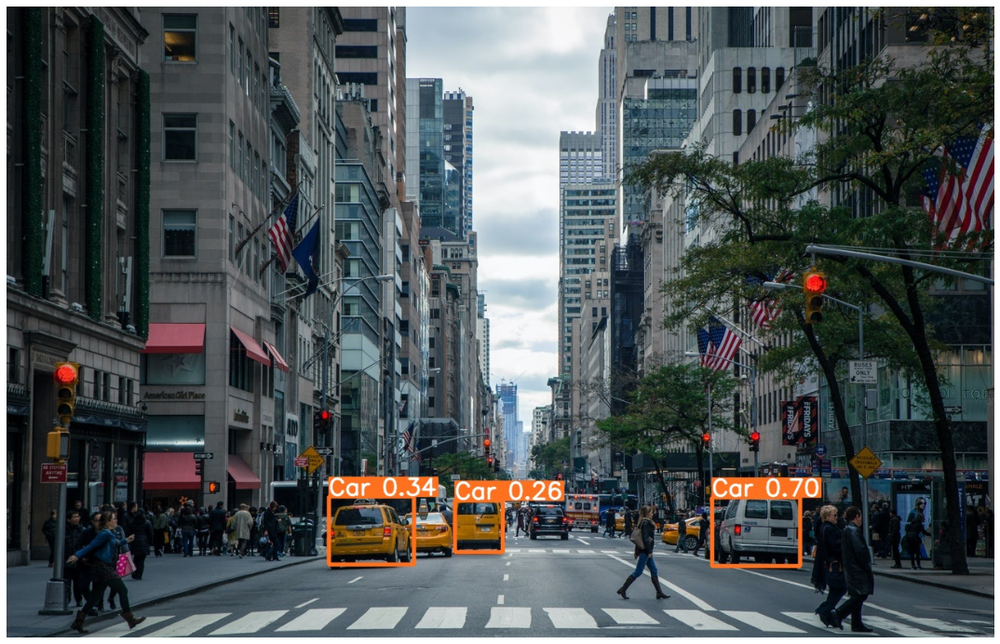

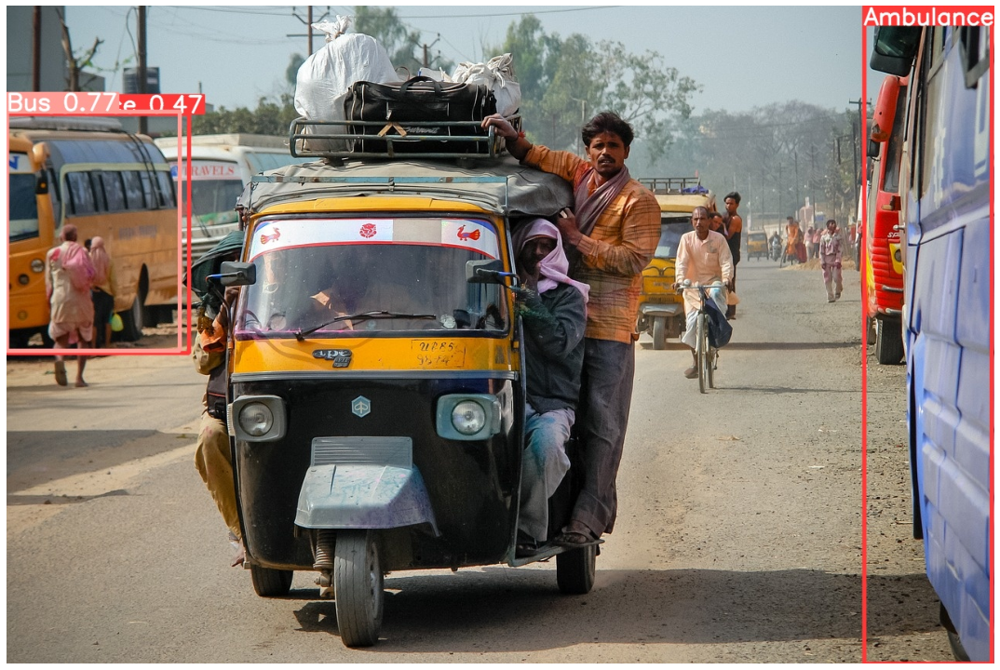

In [ ]:
visualize(IMAGE_INFER_DIR)

## Freezing Layers and Training the Medium Model

The Medium model (yolov5m) contains 25 blocks layers in total more than 20 million parameters. We don't need train all the layers. we can freeze a few layers and train . This will result in faster iteration per epoch and could allow using better model for training on weak devices 

In [ ]:
monitor_tensorboard()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Current number of result directories: 2
results_3
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_3, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 27 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_m

albumentations: Blur(always_apply=False, p=0.01, blur_limit=(3, 7)), MedianBlur(always_apply=False, p=0.01, blur_limit=(3, 7)), ToGray(always_apply=False, p=0.01), CLAHE(always_apply=False, p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
train: Scanning '/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_obj
val: Scanning '/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_objec
Plotting labels to runs/train/results_3/labels.jpg... 

AutoAnchor: 3.85 anchors/target, 1.000 Best Possible Recall (BPR). Current anchors are a good fit to dataset ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/train/results_3
Starting training for 25 epochs...

     Epoch   gpu_mem       box       obj       cls    labels  img_size
      0/24     1.73G    0.1007   0.03514   0.04814        20       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.165       0.

     23/24     2.45G   0.03313   0.02219    0.0164        19       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.642      0.629      0.639      0.447

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     24/24     2.45G   0.03252    0.0219   0.01616        37       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.631      0.631      0.637      0.451

25 epochs completed in 0.231 hours.
Optimizer stripped from runs/train/results_3/weights/last.pt, 42.3MB
Optimizer stripped from runs/train/results_3/weights/best.pt, 42.3MB

Validating runs/train/results_3/weights/best.pt...
Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227  

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 4
inference_5
detect: weights=['runs/train/results_3/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_5, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients
image 1/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_images/image_1.jpg: 448x640 3 Buss, 5 Cars, Done. (0.021s)
image 2/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_us

['runs/detect/inference_5/image_1.jpg', 'runs/detect/inference_5/image_4.jpg', 'runs/detect/inference_5/image_2.jpg', 'runs/detect/inference_5/image_3.jpg']


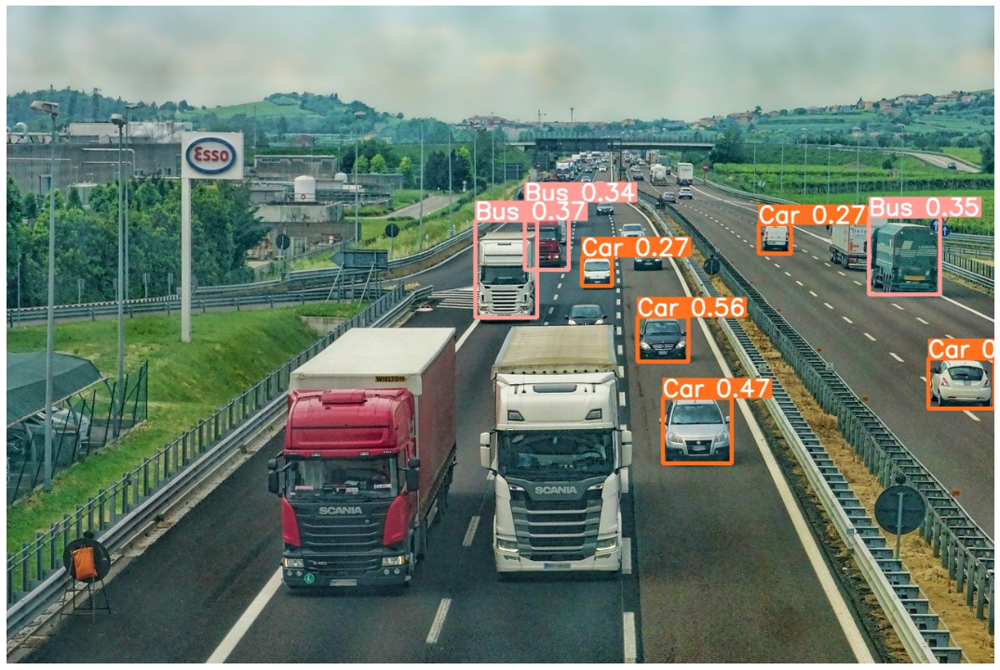

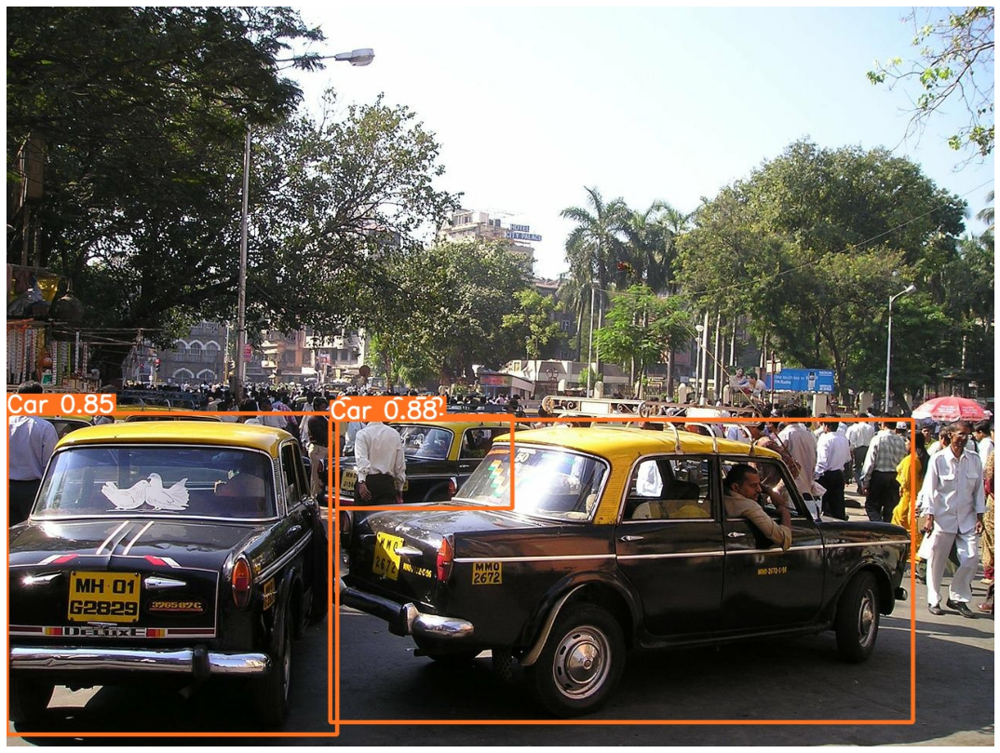

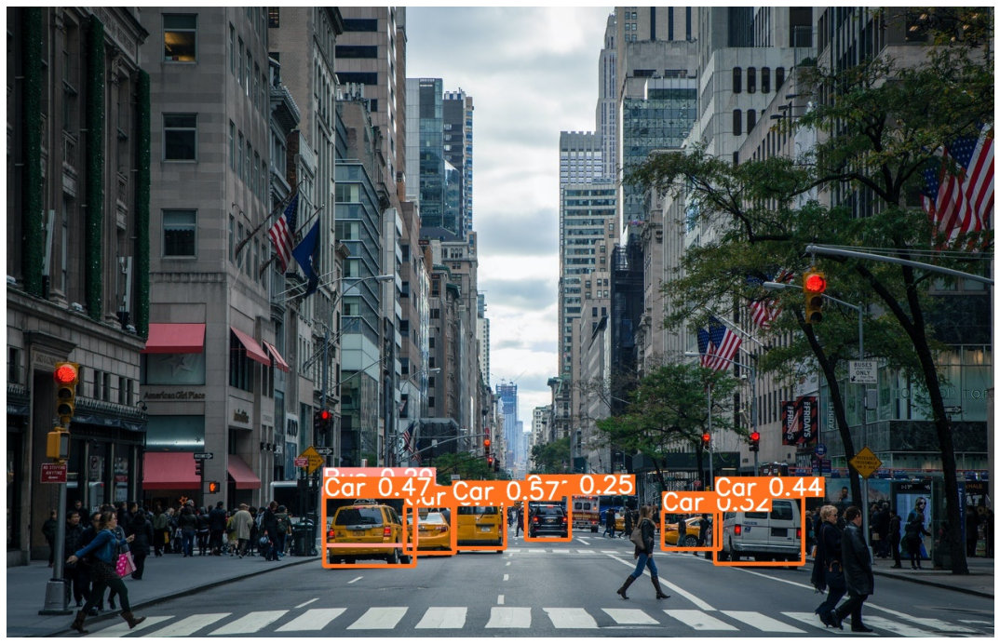

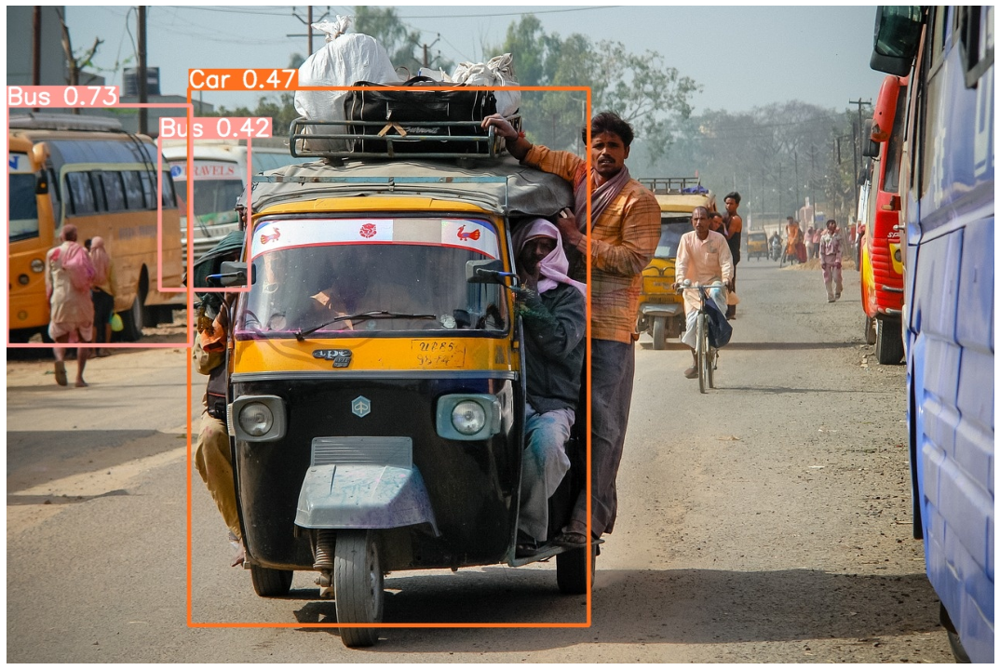

In [ ]:
visualize(IMAGE_INFER_DIR)

NEXT:
  1. print number of vehicles after detecting them write
  2. make inferene works with downloaded best weight
  3. check if there is a way to write the codes without specifeing the paths in each block

TO FIX:

  1. when TRAIN = False the code not working on last trained model.

  2. colours of diff vehicles can be similar when randomly generated , enhance the colouring line